In [291]:
import sys
sys.path.append("models/")
from setup import out_dir, data_dir, image_dir, model_dir, streetview_dir, proj_dir
%load_ext autoreload
%autoreload 2

import glob
import torch

from util_model import parse_args
from dataloader import image_loader, load_demo


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [125]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

zoomlevel = 'zoom15'
latent_dim = 100
demo_dim = 7
demo_cols = [0,1,2,3,4,8,9]
demo_names = ['tot_population','pct25_34yrs','pct35_50yrs','pctover65yrs',
             'pctwhite_alone','avg_tt_to_work','inc_per_capita']
# demo_cols = [0,9]
image_size = str(64)
im_norm = '2'
model_run_date = "2210gan-7"
model_type = 'dcgan'
loss_func = 'mse'
model_class = 'gan'
base_lr = '0.0002'
weight_decay = '0'
sampling = 'clustered'

args = parse_args(s=['--zoomlevel', zoomlevel, '--latent_dim', str(latent_dim+demo_dim), 
                     '--image_size', image_size, \
                     '--im_norm', im_norm, '--model_run_date', model_run_date, '--model_type', model_type, \
                     '--loss_func', loss_func, '--model_class', model_class, \
                     '--base_lr', base_lr, '--weight_decay', weight_decay, \
                     '--demo_channels', str(demo_dim), \
                     '--sampling', sampling])

from util_model import dcgan_config, load_model

config = dcgan_config(args)

run_config = config['run_config']
optim_config = config['optim_config']
data_config = config['data_config']
model_config = config['model_config']

netD = load_model('dcgan', 'Discriminator', config)
netG = load_model('dcgan', 'Generator', config)

netD = netD.to(device)
netG = netG.to(device)

In [126]:
# Satellite
train_loader, test_loader = image_loader(image_dir+args.zoomlevel+"/", data_dir, optim_config['batch_size'], 
         run_config['num_workers'], 
         data_config['image_size'], 
         data_version=args.data_version, 
         sampling=args.sampling, 
         recalculate_normalize=False,
         augment=False,
         norm=args.im_norm,
         demo=True)

28280 images in dataset
3140 images in dataset


In [127]:
# Check one model exists for this config
model_path = glob.glob(model_dir+"cGAN_"+zoomlevel+"_"+str(model_config['latent_dim'])+"_"+
                model_run_date+"_200.pt")
#
if len(model_path) == 1:
    saved = torch.load(model_path[0])
    print(model_path[0], "loaded.")
else:
    print("Error. More than one model or no model exists.")
    print(model_path)
    print(model_dir+"cGAN_"+zoomlevel+"_"+str(model_config['latent_dim'])+"_"+
                model_run_date+"_*.pt")

/dreambig/qingyi/image_chicago/models/cGAN_zoom15_107_2210gan-7_200.pt loaded.


In [128]:
netG.load_state_dict(saved['generator_model_state_dict'])
netD.load_state_dict(saved['discriminator_model_state_dict'])

netG.eval()
netD.eval();

# Ground truth demo (from test set) and noise (randomly generated) vectors

In [129]:
fixed_noise = torch.randn(8, latent_dim, 1, 1, device=device)
census_code = []
noise_demo = []

for step, (image_list, _, demo) in enumerate(test_loader):
    if step == 0:
        noise_demo.append(demo[[0,20,40,60]][:,demo_cols])
        census_code += ["_".join(image_list[i].split('/')[-1].split('_')[:-1]) for i in [0,20,40,60]]
    if step == 1:
        noise_demo.append(demo[[20,40,60]][:,demo_cols])
        census_code += ["_".join(image_list[i].split('/')[-1].split('_')[:-1]) for i in [20,40,60]]
    if step == 2:
        noise_demo.append(demo[[20]][:,demo_cols])
        census_code +=  ["_".join(image_list[i].split('/')[-1].split('_')[:-1]) for i in [20]]
        break
noise_demo = torch.cat(noise_demo, 0).to(device)
noise_demo = noise_demo[:,:,None,None]

# row: same demo vector, different noise vectors
# column: same noise vector, different demo vectors
fixed_noise_ = torch.cat([fixed_noise.repeat(8,1,1,1),noise_demo.repeat_interleave(8, dim=0)], axis=1)


# Ground Truth Images

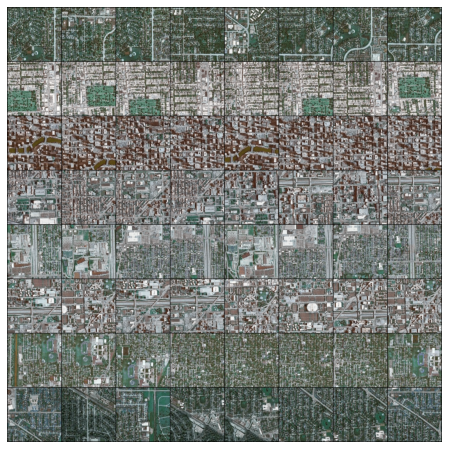

In [117]:
images = []
for c in census_code:
    for i in glob.glob(image_dir+"zoom15/"+c+"_*.png")[:8]:
        im = cv2.imread(i)
        images.append(trans(util_image.center_crop(im, (224,224))))
        

fig, ax = plt.subplots(figsize=(8,8))
ax.axis("off")
ax.imshow(vutils.make_grid(images, normalize=False, padding=2).permute(1,2,0))
plt.show()

# 1. Modify demographics one dim at a time

In [74]:
sub = torch.tensor(np.linspace(-1,1,8)).to(device)

In [116]:
import cv2
from torchvision import transforms
import util_image
import torchvision.utils as vutils

trans = transforms.Compose([transforms.ToTensor()])


In [ ]:
for j in range(8):
    noise_demo_isolate = noise_demo[j,:,:,:].expand(8,-1,-1,-1)

    for i in range(demo_dim):
        noise_demo_isolate_mod = noise_demo_isolate.clone()
        noise_demo_isolate_mod[:,i,0,0] = sub

        fixed_noise_isolate = torch.cat([fixed_noise.repeat(8,1,1,1),
                                         noise_demo_isolate_mod.repeat_interleave(8, dim=0)], axis=1)

        generated = netG(fixed_noise_isolate)

        fig, ax = plt.subplots(1,1,figsize=(8,8))
        ax.axis("off")
        ax.set_title(demo_names[i])
        ax.imshow(np.transpose(torchvision.utils.make_grid(generated, padding=2, normalize=True).cpu(),(1,2,0)));
        fig.savefig(out_dir+"GAN_regen/cGAN_"+zoomlevel+"_"+str(model_config['latent_dim'])+"_"+
                        model_run_date+"_"+census_code[j]+"_"+demo_names[i]+".png", bbox_inches='tight')

        plt.show()


# 2. Modify demographics along principal axes

In [188]:
torch.where(to1 < 0, to1, -torch.inf)

tensor([    -inf,     -inf,  -4.9852,     -inf,     -inf,     -inf, -13.1805],
       device='cuda:1')

In [193]:
neg_dir = max([torch.where(to1 < 0, to1, -torch.inf).max(), torch.where(to_1 < 0, to_1, -torch.inf).max()])
pos_dir = min([torch.where(to1 > 0, to1, torch.inf).min(), torch.where(to_1 > 0, to_1, torch.inf).min()])
print(neg_dir)
print(pos_dir)

tensor(-0.4870, device='cuda:1')
tensor(0.9222, device='cuda:1')


In [198]:
scale.shape

torch.Size([1, 8, 1, 1])

In [200]:
principal_directions.device

device(type='cuda', index=1)

In [201]:
noise_modify.device

device(type='cuda', index=1)

In [154]:
principal_directions = torch.tensor(
[[-0.03728411, 0.00246961, -0.01975988, -0.02013288, -0.94998786,  0.10764258, -0.28938581],
 [-0.17841066, 0.28975564,  0.04034374, -0.01463782, -0.22531456,  0.2804923,   0.86771357],
 [-0.21736798, 0.41486101, -0.07447843, -0.19284605, -0.10112502, -0.85051047,  0.06565473],
 [ 0.0521389,  0.6602031,   0.16070603, -0.52873428,  0.14411694,  0.37349804, -0.30944556],
 [ 0.91982008, -0.03273054, 0.1203044,  -0.20468568, -0.12182291, -0.18379729,  0.21878778],
 [ 0.26237154, 0.5429771,  -0.33855967,  0.71117781,  0.02321181,  0.05483733, -0.11133101]]).to(device)

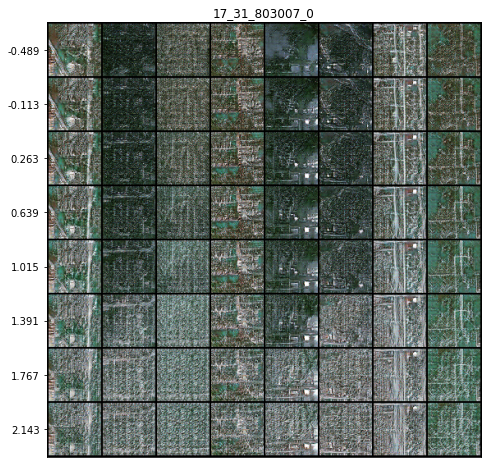

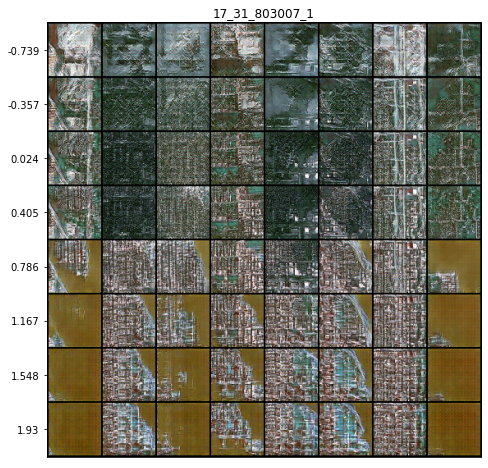

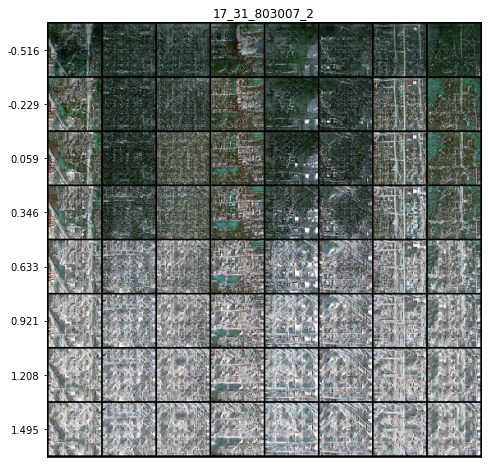

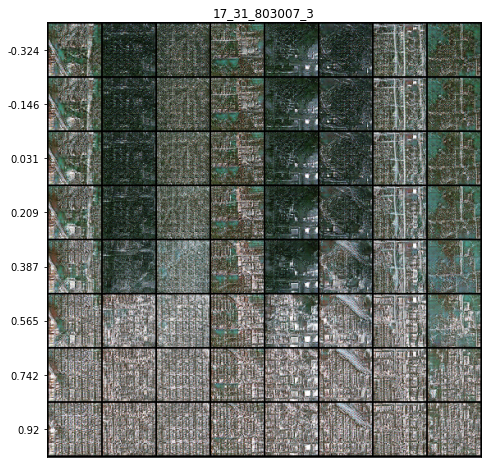

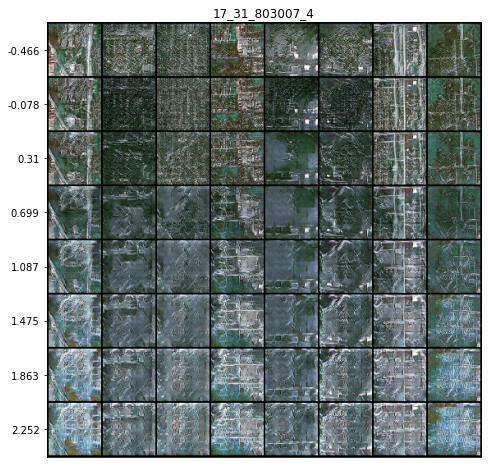

...

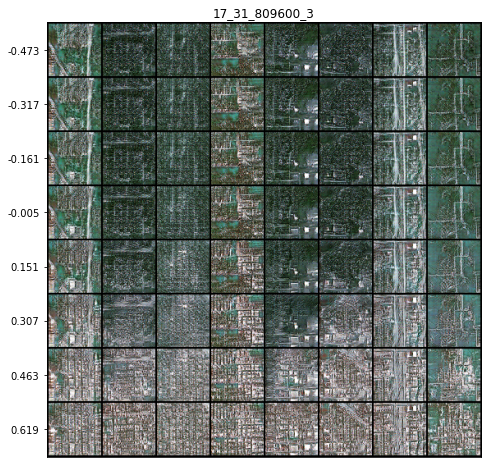

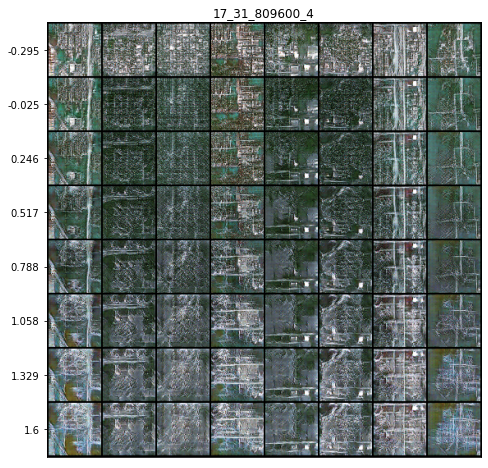

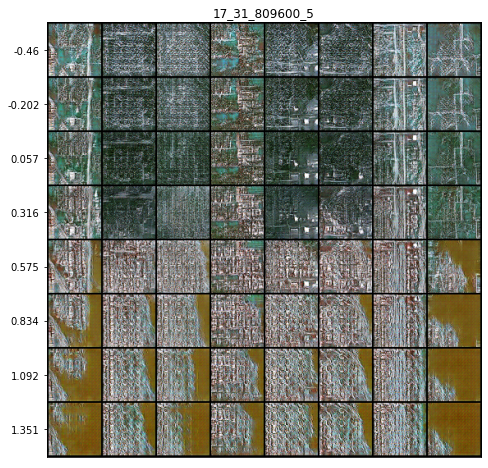

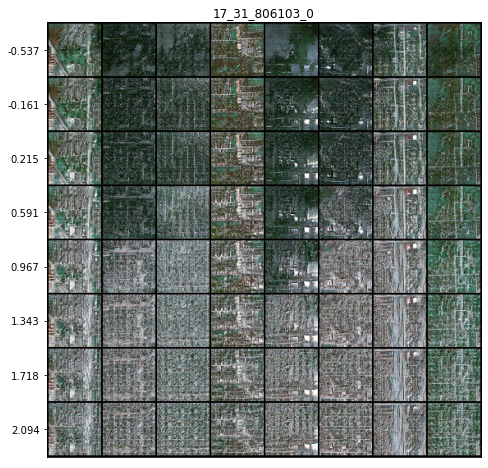

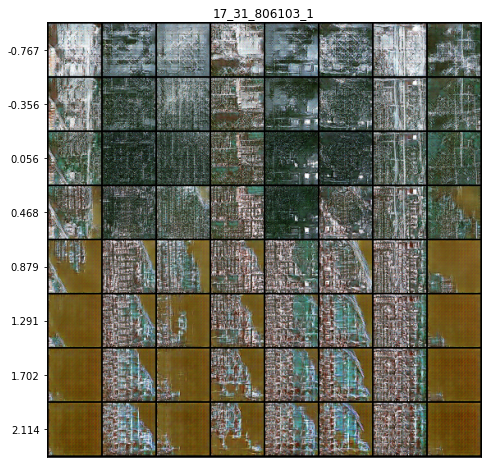

In [ ]:
for j in range(8):
    noise_demo_isolate = noise_demo[j,:,:,:].expand(8,-1,-1,-1)

    for i in range(len(princpal_directions)):
        noise_demo_isolate_mod = noise_demo_isolate.clone()
        
        # Calculate how far we and move in each direction along this principal axis
        to1 = (1-noise_demo[j,:,0,0])/principal_directions[i,:]
        to_1 = (-1-noise_demo[j,:,0,0])/principal_directions[i,:]
        # Extrapolate the limiting dimension 25% (higher values will result in unreasonable images)
        neg_dir = 1.25*max([torch.where(to1 < 0, to1, -torch.inf).max(), torch.where(to_1 < 0, to_1, -torch.inf).max()])
        pos_dir = 1.25*min([torch.where(to1 > 0, to1, torch.inf).min(), torch.where(to_1 > 0, to_1, torch.inf).min()])

        scale = torch.linspace(neg_dir, pos_dir, 8)[:,None].to(device)
        
        noise_modify = (principal_directions[i:i+1,:] * scale)[:,:,None,None]
        noise_demo_isolate_mod += noise_modify
        
        fixed_noise_isolate = torch.cat([fixed_noise.repeat(8,1,1,1),
                                         noise_demo_isolate_mod.repeat_interleave(8, dim=0)], axis=1)

        generated = netG(fixed_noise_isolate)

        fig, ax = plt.subplots(1,1,figsize=(8,8))
        ax.set_title(census_code[j]+"_"+str(i))
        ax.imshow(np.transpose(torchvision.utils.make_grid(generated, padding=2, normalize=True).cpu(),(1,2,0)));
        ax.set_yticks(np.arange(33,500,66))
        ax.set_yticklabels(scale.cpu().detach().numpy().flatten().round(3))
        ax.get_xaxis().set_visible(False)
        fig.savefig(out_dir+"GAN_regen/cGAN_"+zoomlevel+"_"+str(model_config['latent_dim'])+"_"+
                        model_run_date+"_"+str(j)+"_"+str(i)+".png", bbox_inches='tight')

        plt.show()
        

# 3. Produce activations of different layers

In [12]:
# get activation hooks in the discriminator
activation  = {}
    
def get_activation(name):
    def hook(model, input, output):
        activation[name] = output.detach()
    return hook


In [271]:
# Change batch size such that each batch contains images from one census tract only

train_loader, test_loader = image_loader(image_dir+args.zoomlevel+"/", data_dir, 20, 
         run_config['num_workers'], 
         data_config['image_size'], 
         data_version=args.data_version, 
         sampling=args.sampling, 
         recalculate_normalize=False,
         augment=False,
         norm=args.im_norm,
         demo=True)

28280 images in dataset
3140 images in dataset


In [286]:
intermediate_layers_generated_train = [[] for i in range(5)]
intermediate_layers_original_train = [[] for i in range(5)]
intermediate_layers_generated_test = [[] for i in range(5)]
intermediate_layers_original_test = [[] for i in range(5)]

torch.random.manual_seed(9)
noise = torch.randn(20, latent_dim, 1, 1).to(device)

train_ct = []
test_ct = []

for step, (image_list, im, demo) in enumerate(train_loader):

    demo_conv = demo[:,demo_cols,None,None].to(device)
    dis_demo_conv = demo[:,demo_cols,None,None].expand(-1,-1,int(image_size), int(image_size)).to(device)
    fixed_noise_ = torch.cat([noise, demo_conv], dim=1).to(device)
    generated = netG(fixed_noise_)

    netD.main[0].register_forward_hook(get_activation('conv1'))
    netD.main[2].register_forward_hook(get_activation('conv2'))
    netD.main[5].register_forward_hook(get_activation('conv3'))
    netD.main[8].register_forward_hook(get_activation('conv4'))
    netD.main[11].register_forward_hook(get_activation('conv5'))
    output = netD(torch.cat([generated, dis_demo_conv], 1))
    
    for i in range(5):
        intermediate_layers_generated_train[i].append(activation['conv'+str(i+1)].cpu().detach().numpy().mean(axis=0))   
        
    netD.main[0].register_forward_hook(get_activation('conv1'))
    netD.main[2].register_forward_hook(get_activation('conv2'))
    netD.main[5].register_forward_hook(get_activation('conv3'))
    netD.main[8].register_forward_hook(get_activation('conv4'))
    netD.main[11].register_forward_hook(get_activation('conv5'))
    
    im = im.to(device)
    output = netD(torch.cat([im, dis_demo_conv], 1))    

    for i in range(5):
        intermediate_layers_original_train[i].append(activation['conv'+str(i+1)].cpu().detach().numpy().mean(axis=0))
    
    s = image_list[0]
    train_ct.append(s[s.rindex("/")+1: s.rindex("_")])

for step, (image_list, im, demo) in enumerate(test_loader):

    demo_conv = demo[:,demo_cols,None,None].to(device)
    dis_demo_conv = demo[:,demo_cols,None,None].expand(-1,-1,int(image_size), int(image_size)).to(device)
    fixed_noise_ = torch.cat([noise, demo_conv], dim=1).to(device)
    generated = netG(fixed_noise_)

    netD.main[0].register_forward_hook(get_activation('conv1'))
    netD.main[2].register_forward_hook(get_activation('conv2'))
    netD.main[5].register_forward_hook(get_activation('conv3'))
    netD.main[8].register_forward_hook(get_activation('conv4'))
    netD.main[11].register_forward_hook(get_activation('conv5'))
    output = netD(torch.cat([generated, dis_demo_conv], 1))
    
    for i in range(5):
        intermediate_layers_generated_test[i].append(activation['conv'+str(i+1)].cpu().detach().numpy().mean(axis=0))   
        
    netD.main[0].register_forward_hook(get_activation('conv1'))
    netD.main[2].register_forward_hook(get_activation('conv2'))
    netD.main[5].register_forward_hook(get_activation('conv3'))
    netD.main[8].register_forward_hook(get_activation('conv4'))
    netD.main[11].register_forward_hook(get_activation('conv5'))
    
    im = im.to(device)
    output = netD(torch.cat([im, dis_demo_conv], 1))
    
    for i in range(5):
        intermediate_layers_original_test[i].append(activation['conv'+str(i+1)].cpu().detach().numpy().mean(axis=0))
    
    s = image_list[0]
    test_ct.append(s[s.rindex("/")+1: s.rindex("_")])
    

In [287]:
for i in range(5):
    intermediate_layers_original_train[i] = np.array(intermediate_layers_original_train[i])
    intermediate_layers_generated_train[i] = np.array(intermediate_layers_generated_train[i])
    intermediate_layers_original_test[i] = np.array(intermediate_layers_original_test[i])
    intermediate_layers_generated_test[i] = np.array(intermediate_layers_generated_test[i])

In [274]:
print(activation['conv1'].shape)
print(activation['conv2'].shape)
print(activation['conv3'].shape)
print(activation['conv4'].shape)
print(activation['conv5'].shape)

torch.Size([20, 64, 32, 32])
torch.Size([20, 128, 16, 16])
torch.Size([20, 256, 8, 8])
torch.Size([20, 512, 4, 4])
torch.Size([20, 107, 1, 1])


In [294]:
import pickle as pkl

with open(proj_dir+"latent_space/cGAN_"+zoomlevel+"_"+str(model_config['latent_dim'])+"_"+
                model_run_date+"_9.pkl", "wb") as f: 
    
    pkl.dump(intermediate_layers_original_train, f)
    pkl.dump(intermediate_layers_generated_train, f)
    pkl.dump(intermediate_layers_original_test, f)
    pkl.dump(intermediate_layers_generated_test, f)
    pkl.dump(train_ct, f)
    pkl.dump(test_ct, f)
    

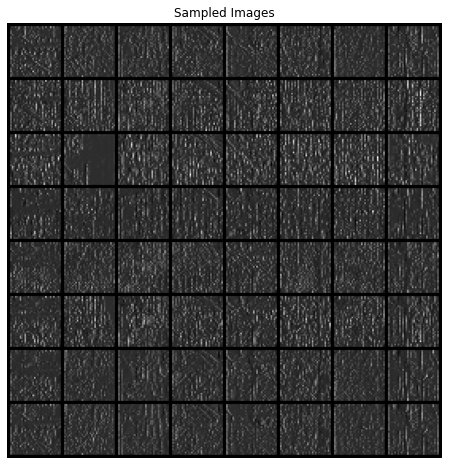

In [48]:
fig, ax = plt.subplots(1,1,figsize=(8,8))
ax.axis("off")
ax.set_title("Sampled Images")
ax.imshow(np.transpose(torchvision.utils.make_grid(activation['conv1'][:,4:5,:,:], padding=2, normalize=True).cpu(),(1,2,0)));


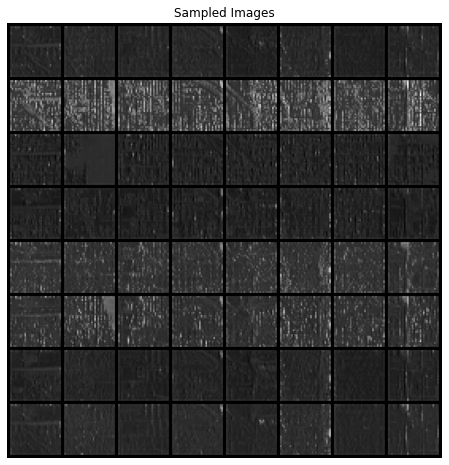

In [56]:
fig, ax = plt.subplots(1,1,figsize=(8,8))
ax.axis("off")
ax.set_title("Sampled Images")
ax.imshow(np.transpose(torchvision.utils.make_grid(activation['conv1'][:,40:41,:,:], padding=2, normalize=True).cpu(),(1,2,0)));


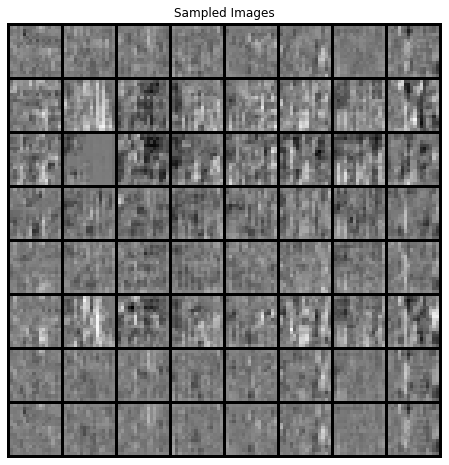

In [57]:
fig, ax = plt.subplots(1,1,figsize=(8,8))
ax.axis("off")
ax.set_title("Sampled Images")
ax.imshow(np.transpose(torchvision.utils.make_grid(activation['conv2'][:,14:15,:,:], padding=1, normalize=True).cpu(),(1,2,0)));


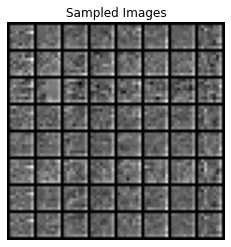

In [53]:
fig, ax = plt.subplots(1,1,figsize=(4,4))
ax.axis("off")
ax.set_title("Sampled Images")
ax.imshow(np.transpose(torchvision.utils.make_grid(activation['conv3'][:,4:5,:,:], padding=1, normalize=True).cpu(),(1,2,0)));


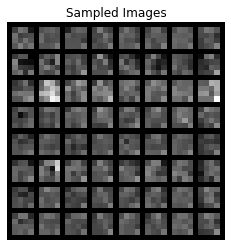

In [54]:
fig, ax = plt.subplots(1,1,figsize=(4,4))
ax.axis("off")
ax.set_title("Sampled Images")
ax.imshow(np.transpose(torchvision.utils.make_grid(activation['conv4'][:,4:5,:,:], padding=1, normalize=True).cpu(),(1,2,0)));
